# Load Field data, PVSyst and DAS result files and run cap test

In [1]:
fielddataFolder = 'FieldData'
InputFilesFolder = 'InputFiles'
SAMResultsFolder = 'SAM'

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import pvlib
import numpy as np
import os
from pathlib import Path
from datetime import datetime

In [3]:
plt.rcParams.update({'font.size': 22})
plt.rcParams['figure.figsize'] = (12, 4)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
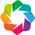

Loading BokehJS ...

In [4]:
# pip install pvcaptest and holoviews if you don't have it installed already.
# following example from https://pvcaptest.readthedocs.io/en/latest/examples/complete_capacity_test.html

#import captest as pvc
from captest import capdata as pvc
from bokeh.io import output_notebook, show

# uncomment below two lines to use cptest.scatter_hv in notebook
import holoviews as hv
hv.extension('bokeh')

#if working offline with the CapData.plot() method may fail
#run 'export BOKEH_RESOURCES=inline' at the command line before
#running the jupyter notebook

output_notebook()

In [5]:
# Load 15-minute field data, 6/1/21 - 5/31/22

In [6]:
# instantiating a CapData object, which we will use to load and store the SAM data.
das = pvc.CapData('das')
das.load_data(fname='Row9_2021-2022_15T.csv', source='AlsoEnergy')  # the AlsoEnergy flag is needed to make this work.
das.data.columns




Index(['Gfront_poa', 'Grear', 'row2wind_speed', 'temp_ambient_FieldAverage',
       'row9_inv', 'row9tmod_1', 'row9tmod_2', 'albedo_down', 'albedo_up',
       'row7RotatingAlbedometer_CM11_Down', 'row7RotatingAlbedometer_CM11_Up',
       'index'],
      dtype='object')

In [7]:
# dropping na's in POA or DC power
das.data = das.data[(das.data['Gfront_poa'].notna())&(das.data['row9_inv'].notna())]
das.review_column_groups()

temp-amb-
    temp_ambient_FieldAverage
-inv-
    row9_inv
-mtr-
    row7RotatingAlbedometer_CM11_Down
    row7RotatingAlbedometer_CM11_Up
irr-poa-
    Gfront_poa
wind--
    row2wind_speed
-mod-
    row9tmod_1
    row9tmod_2
index--
    index
--
    Grear
    albedo_down
    albedo_up


In [8]:
das.set_regression_cols(power='-inv-', poa='irr-poa-', t_amb='temp-amb-', w_vel='wind--')
das.plot(marker='line', width=900, height=250, ncols=1)

Added new group: irr_comb
Added new group: temp_comb


In [9]:
das.reset_filter()
das.rview('poa').iloc[100:103, :]
das.scatter_hv(timeseries=False) 

:Scatter   [poa]   (power,w_vel,index)

In [10]:
das.filter_outliers()
das.filter_irr(100,2000)
das.get_summary()

pts_after_filter  pts_removed   filter_arguments
das filter_outliers             32784         1366  Default arguments
    filter_irr                  12056        20728       100,  2000,

In [11]:
das.rep_cond()

Reporting conditions saved to rc attribute.
          poa      t_amb     w_vel
0  779.821847  17.482097  2.082312


In [12]:
das.filter_irr(0.5, 1.5, ref_val=das.rc['poa'][0])  # filter around +/- 50% of POA RC's

In [13]:
das.scatter_hv(timeseries=True)

:Layout
   .Scatter.I :Scatter   [poa]   (power,w_vel,index)
   .Curve.I   :Curve   [date]   (power,poa)

In [14]:
das.fit_regression()

                                 OLS Regression Results                                
Dep. Variable:                  power   R-squared (uncentered):                   0.999
Model:                            OLS   Adj. R-squared (uncentered):              0.999
Method:                 Least Squares   F-statistic:                          3.245e+06
Date:                Thu, 22 Dec 2022   Prob (F-statistic):                        0.00
Time:                        10:03:41   Log-Likelihood:                          4340.0
No. Observations:                8931   AIC:                                     -8672.
Df Residuals:                    8927   BIC:                                     -8644.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------

In [15]:
help(das.fit_regression)

Help on method fit_regression in module captest.capdata:

fit_regression(filter=False, inplace=True, summary=True) method of captest.capdata.CapData instance
    Perform a regression with statsmodels on filtered data.
    
    Parameters
    ----------
    filter: bool, default False
        When true removes timestamps where the residuals are greater than
        two standard deviations.  When false just calcualtes ordinary least
        squares regression.
    inplace: bool, default True
        If filter is true and inplace is true, then function overwrites the
        filtered data for sim or das.  If false returns a CapData object.
    summary: bool, default True
        Set to false to not print regression summary.
    
    Returns
    -------
    CapData
        Returns a filtered CapData object if filter is True and inplace is
        False.



In [15]:
das.get_summary()

pts_after_filter  pts_removed  \
das filter_outliers             32784         1366   
    filter_irr                  12056        20728   
    rep_cond                    12056            0   
    filter_irr-1                 8933         3123   
    fit_regression               8933            0   

                                filter_arguments  
das filter_outliers            Default arguments  
    filter_irr                      100,  2000,   
    rep_cond                   Default arguments  
    filter_irr-1     0.5,  1.5, ref_val: 779.822  
    fit_regression             Default arguments

In [16]:
print(das.regression_results.params)
print(das.regression_results.pvalues)

poa               0.008416
I(poa * poa)     -0.000001
I(poa * t_amb)   -0.000020
I(poa * w_vel)    0.000045
dtype: float64
poa                0.000000e+00
I(poa * poa)       0.000000e+00
I(poa * t_amb)     0.000000e+00
I(poa * w_vel)    2.479128e-195
dtype: float64


In [17]:
# PVSyst comparison test

In [18]:
sim = pvc.CapData('sim')


In [19]:
sim.load_data(load_pvsyst=True)

Read: PVSyst_Tracker_VC4_HourlyRes_2020_2.CSV
Skipped file: Row2_Row9_2021-2022_15T.csv
Skipped file: Row9_2021-2022_15T.csv
Skipped file: Row9_SAM_60_Comb_00a.csv
145.23 in IL Oper is above 10 for op_state
82.398 in ShdLoss is above 1 for shade
38.209 in ShdDLss is above 1 for shade
55.87 in ShdALss is above 1 for shade
-274.56 in TempLss is below -49 for temp
1243.5 in TempLss is above 127 for temp
93.02 in OP_Oper is above 10 for op_state


In [20]:
sim.column_groups

{'temp-mod-': ['TArray'],
 'wind--': ['WindVel'],
 'index--': ['index'],
 'irr-ghi-': ['GlobHor'],
 '-inv-': ['EOutInv', 'EffInvB', 'EffInvR', 'InvLoss'],
 'op_state--': ['IL Oper', 'OP_Oper', 'OP_PMax', 'OP_PMin'],
 'shade--': ['FIAMShd',
  'FShdAlb',
  'FShdBm',
  'FShdDif',
  'FShdGl',
  'ShdALss',
  'ShdBLss',
  'ShdDLss',
  'ShdLoss'],
 'temp--': ['TempLss'],
 'temp-amb-': ['FIAMBm', 'IAMBLss', 'TAmb'],
 'irr-poa-': ['GlobInc'],
 'real_pwr--': ['E_Grid'],
 '--ref_cell': ['EArrRef'],
 '-mod-': ['ModQual'],
 'irr--': ['GlobEff', 'GlobIAM', 'GlobShd'],
 'pvsyt_losses--': ['IL Pmax', 'IL Pmin', 'IL Vmax', 'IL Vmin'],
 '--': ['Alb Inc',
  'Alb/Gl',
  'Alb_Eff',
  'AngInc',
  'AngProf',
  'ArrayON',
  'AzSol',
  'BeamEff',
  'BeamHor',
  'BeamInc',
  'Bm/Gl',
  'DTArr',
  'DTArrGl',
  'DifS/Gl',
  'DifSInc',
  'Diff/Gl',
  'DiffEff',
  'DiffHor',
  'EArrMPP',
  'EArrNom',
  'EArray',
  'EffArrC',
  'EffArrR',
  'EffSysC',
  'EffSysR',
  'FEffAlb',
  'FEffDif',
  'FIAMAlb',
  'FIAMDif',


In [21]:
sim.data.E_Grid = sim.data.E_Grid / 1000  # W to kW

In [22]:
sim.set_regression_cols(power='real_pwr--', poa='irr-poa-', t_amb='TAmb', w_vel='wind--')

In [23]:
sim.plot()

Added new group: irr_comb
Added new group: temp_comb


In [24]:
sim.reset_filter()
sim.scatter_hv()

:Scatter   [poa]   (power,w_vel,index)

In [25]:
sim.filter_time(test_date='03/11/2020', days=60)
sim.filter_irr(200, 930)
sim.filter_pvsyst()
sim.filter_irr(0.5, 1.5, ref_val=das.rc['poa'][0])

In [26]:
sim.get_summary()

pts_after_filter  pts_removed  \
sim filter_time                1441         7343   
    filter_irr                  425         1016   
    filter_pvsyst               425            0   
    filter_irr-1                335           90   

                                  filter_arguments  
sim filter_time    test_date: 03/11/2020, days: 60  
    filter_irr                         200,  930,   
    filter_pvsyst                Default arguments  
    filter_irr-1       0.5,  1.5, ref_val: 779.822

In [27]:
sim.fit_regression()

                                 OLS Regression Results                                
Dep. Variable:                  power   R-squared (uncentered):                   0.998
Model:                            OLS   Adj. R-squared (uncentered):              0.998
Method:                 Least Squares   F-statistic:                          4.457e+04
Date:                Fri, 11 Nov 2022   Prob (F-statistic):                        0.00
Time:                        13:55:50   Log-Likelihood:                          16.928
No. Observations:                 335   AIC:                                     -25.86
Df Residuals:                     331   BIC:                                     -10.60
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------

In [28]:
sim.scatter_hv()

:Scatter   [poa]   (power,w_vel,index)

In [29]:
pvc.get_summary(das, sim)

pts_after_filter  pts_removed  \
das filter_outliers             32784         1366   
    filter_irr                  12056        20728   
    rep_cond                    12056            0   
    filter_irr-1                 8933         3123   
    fit_regression               8933            0   
sim filter_time                  1441         7343   
    filter_irr                    425         1016   
    filter_pvsyst                 425            0   
    filter_irr-1                  335           90   
    fit_regression                335            0   

                                    filter_arguments  
das filter_outliers                Default arguments  
    filter_irr                          100,  2000,   
    rep_cond                       Default arguments  
    filter_irr-1         0.5,  1.5, ref_val: 779.822  
    fit_regression                 Default arguments  
sim filter_time      test_date: 03/11/2020, days: 60  
    filter_irr                           200,  930,   
    filter_pvsyst                  Default arguments  
    filter_irr-1         0.5,  1.5, ref_val: 779.822  
    fit_regression                 Default arguments

In [30]:
pvc.captest_results_check_pvalues(sim, das, 6000, '+/- 7', print_res=True)

Using reporting conditions from das. 

Capacity Test Result:         PASS
Modeled test output:          5.340
Actual test output:           5.646
Tested output ratio:          1.057
Tested Capacity:              6343.925
Bounds:                       5580.0, 6420.0


Using reporting conditions from das. 

Capacity Test Result:         PASS
Modeled test output:          5.340
Actual test output:           5.646
Tested output ratio:          1.057
Tested Capacity:              6343.925
Bounds:                       5580.0, 6420.0


105.730% - Cap Ratio
105.730% - Cap Ratio after pval check


,das_pvals,sim_pvals,das_params,sim_params
poa,0.00000,0.00000,0.00842,0.00864
I(poa * poa),0.00000,0.00000,-0.00000,-0.00000
I(poa * t_amb),0.00000,0.00000,-0.00002,-0.00003
I(poa * w_vel),0.00000,0.00329,0.00005,0.00004


In [49]:
# instantiating a CapData object, which we will use to load and store the simulated SAM data.
sam = pvc.CapData('sim')


In [50]:
"""
datafile = r'data/Row9_SAM_60_Comb_00a.csv'
df = pd.read_csv(datafile)
weatherfile = os.path.join(Path(os.getcwd()).parent,InputFilesFolder,'BEST_SAM_60_Comb_00a.csv')
df_weather = pd.read_csv(weatherfile, skiprows=2)

# set index 
print(df_weather.head())
df.index = pd.to_datetime(df_weather.iloc[:,0:4])
#df.to_csv(datafile)
"""

"\ndatafile = r'data/Row9_SAM_60_Comb_00a.csv'\ndf = pd.read_csv(datafile)\nweatherfile = os.path.join(Path(os.getcwd()).parent,InputFilesFolder,'BEST_SAM_60_Comb_00a.csv')\ndf_weather = pd.read_csv(weatherfile, skiprows=2)\n\n# set index \nprint(df_weather.head())\ndf.index = pd.to_datetime(df_weather.iloc[:,0:4])\n#df.to_csv(datafile)\n"

In [51]:
sam.load_data(fname='Row9_SAM_60_Comb_00a.csv', source='AlsoEnergy')  # the AlsoEnergy flag is needed to make this work.
#sam.set_regression_cols(power=power_string, poa=poa_string, t_amb=t_amb_string, w_vel=w_vel_string)
#sam.regression_cols = {'power':power_string, 'poa':poa_string, 't_amb':t_amb_string, 'w_vel':w_vel_string}

In [52]:
sam.data.columns

Index(['Weather file wind speed | (m/s)',
       'Weather file ambient temperature | (C)',
       'Subarray 1 POA front total irradiance after shading and soiling | (W/m2)',
       'Irradiance GHI from weather file | (W/m2)',
       'Irradiance DNI from weather file | (W/m2)',
       'Inverter AC output power | (kW)',
       'Subarray 1 POA rear total irradiance after reflection (IAM) | (W/m2)',
       'Albedo', 'index'],
      dtype='object')

In [53]:
sam.data['Inverter AC output power | (kW)'] = sam.data['Inverter AC output power | (kW)'] / 10

In [54]:
sam.review_column_groups()

wind--
    Weather file wind speed | (m/s)
index--
    index
irr-ghi-
    Irradiance GHI from weather file | (W/m2)
-inv-
    Inverter AC output power | (kW)
irr-poa-ref_cell
    Subarray 1 POA rear total irradiance after reflection (IAM) | (W/m2)
temp-amb-
    Weather file ambient temperature | (C)
irr-poa-
    Subarray 1 POA front total irradiance after shading and soiling | (W/m2)
irr--
    Irradiance DNI from weather file | (W/m2)
--
    Albedo


In [55]:
sam.set_regression_cols(power='-inv-', poa='irr-poa-', t_amb='temp-amb-', w_vel='wind--')

In [56]:
sam.reset_filter()

sam.scatter_hv(timeseries=True)

:Layout
   .Scatter.I :Scatter   [poa]   (power,w_vel,index)
   .Curve.I   :Curve   [date]   (power,poa)

In [57]:
sam.filter_outliers()
#sam.filter_irr(100,2000)

sam.fit_regression(filter=True, summary=False)

#sam.filter_time(test_date='03/11/2020', days=60)
sam.filter_irr(200, 930)
#sam.filter_pvsyst()
sam.filter_irr(0.5, 1.5, ref_val=das.rc['poa'][0])


sam.get_summary()

NOTE: Regression used to filter outlying points.




pts_after_filter  pts_removed  \
sim filter_outliers              8409          351   
    fit_regression               7970          439   
    filter_irr                   2056         5914   
    filter_irr-1                 1729          327   

                                 filter_arguments  
sim filter_outliers             Default arguments  
    fit_regression   filter: True, summary: False  
    filter_irr                        200,  930,   
    filter_irr-1      0.5,  1.5, ref_val: 779.822

In [58]:
sam.fit_regression()

                                 OLS Regression Results                                
Dep. Variable:                  power   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          9.760e+05
Date:                Fri, 11 Nov 2022   Prob (F-statistic):                        0.00
Time:                        14:02:54   Log-Likelihood:                          1434.0
No. Observations:                1729   AIC:                                     -2860.
Df Residuals:                    1725   BIC:                                     -2838.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                     coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------

In [59]:
sam.scatter_hv()

:Scatter   [poa]   (power,w_vel,index)

In [60]:
pvc.get_summary(das, sam)

pts_after_filter  pts_removed  \
das filter_outliers              32784         1366   
    filter_irr                   12056        20728   
    rep_cond                     12056            0   
    filter_irr-1                  8933         3123   
    fit_regression                8933            0   
sim filter_outliers               8409          351   
    fit_regression                7970          439   
    filter_irr                    2056         5914   
    filter_irr-1                  1729          327   
    fit_regression-1              1729            0   

                                  filter_arguments  
das filter_outliers              Default arguments  
    filter_irr                        100,  2000,   
    rep_cond                     Default arguments  
    filter_irr-1       0.5,  1.5, ref_val: 779.822  
    fit_regression               Default arguments  
sim filter_outliers              Default arguments  
    fit_regression    filter: True, summary: False  
    filter_irr                         200,  930,   
    filter_irr-1       0.5,  1.5, ref_val: 779.822  
    fit_regression-1             Default arguments

In [61]:
pvc.captest_results_check_pvalues(sam, das, 6000, '+/- 7', print_res=True)

Using reporting conditions from das. 

Capacity Test Result:         PASS
Modeled test output:          5.390
Actual test output:           5.646
Tested output ratio:          1.048
Tested Capacity:              6285.464
Bounds:                       5580.0, 6420.0


Using reporting conditions from das. 

Capacity Test Result:         PASS
Modeled test output:          5.390
Actual test output:           5.646
Tested output ratio:          1.048
Tested Capacity:              6285.464
Bounds:                       5580.0, 6420.0


104.760% - Cap Ratio
104.760% - Cap Ratio after pval check


,das_pvals,sim_pvals,das_params,sim_params
poa,0.00000,0.00000,0.00842,0.00720
I(poa * poa),0.00000,0.00001,-0.00000,-0.00000
I(poa * t_amb),0.00000,0.00000,-0.00002,-0.00001
I(poa * w_vel),0.00000,0.00000,0.00005,-0.00002
